# Magpylib fundamentals
##  Step 0:
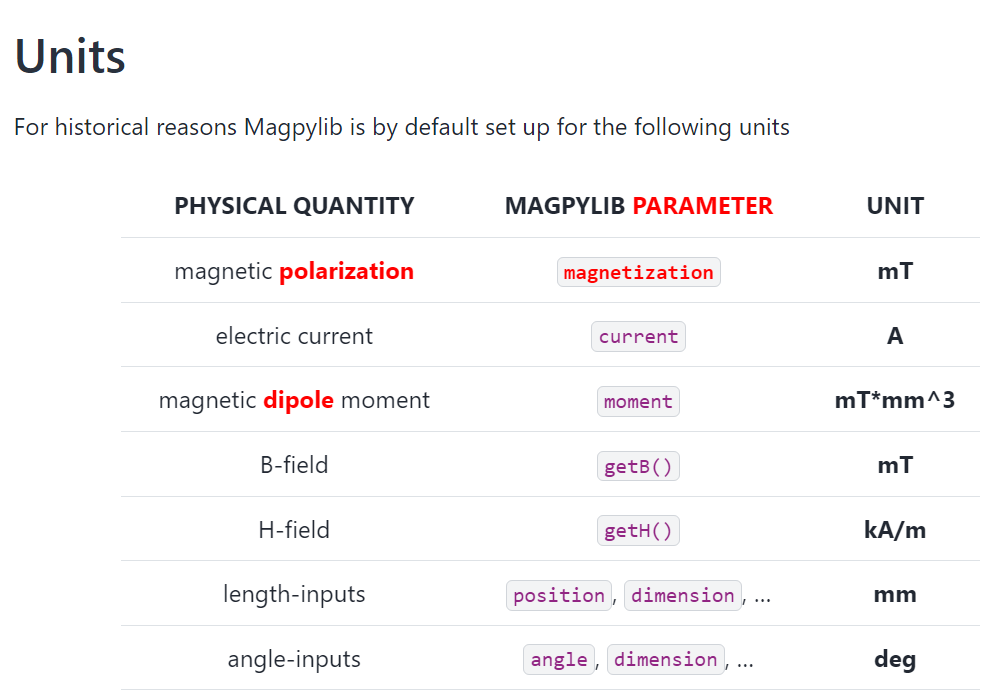
##  Step 1: Create sources and observers as Python objects

In [1]:
import magpylib as magpy

# Create a Cuboid magnet with magnetic polarization
# of 1000 mT pointing in x-direction and sides of
# 1,2 and 3 mm respectively.

cube = magpy.magnet.Cuboid(magnetization=(1000,0,0), dimension=(1,2,3))

# Create a Sensor for measuring the field

sensor = magpy.Sensor()

## Step2: Manipulate object position and orientation

In [2]:
# By default, the position of a Magpylib object is
# (0,0,0) and its orientation is the unit rotation,
# given by a scipy rotation object.

print(cube.position)                   # -> [0. 0. 0.]
print(cube.orientation.as_rotvec())    # -> [0. 0. 0.]

# Manipulate object position and orientation through
# the respective attributes:

from scipy.spatial.transform import Rotation as R
cube.position = (1,0,0)
cube.orientation = R.from_rotvec((0,0,45), degrees=True)

print(cube.position)                            # -> [1. 0.  0.]
print(cube.orientation.as_rotvec(degrees=True)) # -> [0. 0. 45.]

# Apply relative motion with the powerful `move`
# and `rotate` methods.
sensor.move((-1,0,0))
sensor.rotate_from_angax(angle=-45, axis='z')

print(sensor.position)                            # -> [-1.  0.  0.]
print(sensor.orientation.as_rotvec(degrees=True)) # -> [ 0.  0. -45.]

[0. 0. 0.]
[0. 0. 0.]
[1. 0. 0.]
[ 0.  0. 45.]
[-1.  0.  0.]
[  0.   0. -45.]


## Step 3: View your system

In [4]:
# Use the `show` function to view your system
# through Matplotlib, Plotly or Pyvista backends.

magpy.show(cube, sensor, backend='plotly')

##  Step 4: Compute the magnetic field

In [5]:
# Compute the B-field in units of mT for some points.

points = [(0,0,-1), (0,0,0), (0,0,1)]
B = magpy.getB(cube, points)

print(B.round()) # -> [[263.  68.  81.]
                 #     [276.  52.   0.]
                 #     [263.  68. -81.]]

# Compute the H-field in units of kA/m at the sensor.

H = magpy.getH(cube, sensor)

print(H.round()) # -> [220.  41.   0.]

# Magpylib makes use of vectorized computation (massive speedup). 
# This requires that you hand over all field computation 
# instances (multiple objects with multiple positions (=paths)) 
# at the same time to getB or getH. Avoid Python loops at all costs !!!

[[263.  68.  81.]
 [276.  52.   0.]
 [263.  68. -81.]]
[51. 24.  0.]


# Other important features
## Path 
Magpylib position and orientation attributes can store multiple values that are referred to as paths. The field will automatically be computed for all path positions. Use this to model objects moving to multiple locations.

In [6]:
import numpy as np
import magpylib as magpy

# Create magnet
sphere = magpy.magnet.Sphere(diameter=1, magnetization=(0,0,1000))

# Assign a path
sphere.position = np.linspace((-2,0,0), (2,0,0), 7)

# The field is automatically computed for every path position
B = sphere.getB((0,0,1))
print(B.round())  # ->[[  4.   0.  -1.]
                  #    [ 13.   0.   1.]
                  #    [ 33.   0.  26.]
                  #    [  0.   0.  83.]
                  #    [-33.   0.  26.]
                  #    [-13.   0.   1.]
                  #    [ -4.   0.  -1.]]

[[  4.   0.  -1.]
 [ 13.   0.   1.]
 [ 33.   0.  26.]
 [  0.   0.  83.]
 [-33.   0.  26.]
 [-13.   0.   1.]
 [ -4.   0.  -1.]]


##  Collections
Magpylib objects can be grouped into Collections. An operation applied to a Collection is applied to every object in it.


In [1]:
import magpylib as magpy

# Create objects
obj1 = magpy.Sensor()
obj2 = magpy.magnet.Cuboid(magnetization=(0,0,1000), dimension=(1,2,3))

# Group objects
coll = magpy.Collection(obj1, obj2)

# Manipulate Collection
coll.move((1,2,3))

print(obj1.position.round()) # -> [1. 2. 3.]
print(obj2.position.round()) # -> [1. 2. 3.]

[1. 2. 3.]
[1. 2. 3.]


##  Complex Magnet Shapes

There most convenient way to create a magnet with complex shape is by using the ConvexHull of a point cloud (= simplest form that includes all given points).

In [1]:
import magpylib as magpy
# Create a Pyramid magnet
points = [
    (-1,-1, 0),
    (-1, 1, 0),
    ( 1,-1, 0),
    ( 1, 1, 0),
    ( 0, 0, 2),
]
pyramid = magpy.magnet.TriangularMesh.from_ConvexHull(
    magnetization=(0,0,1000),
    points=points
)

# Display the magnet graphically
pyramid.show()

## Graphic Styles
Magpylib offers many ways to customize the graphic output.

In [8]:
import magpylib as magpy

# create Cuboid magnet with custom style
cube = magpy.magnet.Cuboid(
    magnetization=(0,0,1000),
    dimension=(1,1,1),
    style_color='r',
    style_magnetization_mode='arrow'
)

# create Cylinder magnet with custom style
cyl = magpy.magnet.Cylinder(
    magnetization=(0,0,1000),
    dimension=(1,1),
    position=(2,0,0),
    style_magnetization_color_mode='bicolor',
    style_magnetization_color_north='m',
    style_magnetization_color_south='c',
)
magpy.show(cube, cyl)

# Animation
Object paths can be animated

In [2]:
import numpy as np
import magpylib as magpy


# Create magnet with path
cube = magpy.magnet.Cuboid(magnetization=(0,0,1000), dimension=(1,1,1))
cube.rotate_from_angax(angle=np.linspace(10,360,18), axis='x')

# Generate an animation with `show`
cube.show(animation=True, backend="plotly")

## Direct interface
Magpylib’s object oriented interface is convenient to work with but is also slowed down by object initialization and handling. The direct interface bypasses this load and enables field computation for a set of input parameters.

In [10]:
import magpylib as magpy

# Compute the magnetic field via the direct interface.
B = magpy.getB(
    sources="Cuboid",
    observers=[(-1,0,1), (0,0,1), (1,0,1)],
    dimension=(1,1,1),
    magnetization=(0,0,1000)
)

print(B.round()) # -> [[-43.   0.  14.]
                 #     [  0.   0. 135.]
                 #     [ 43.   0.  14.]]

[[-43.   0.  14.]
 [  0.   0. 135.]
 [ 43.   0.  14.]]


In [3]:
import magpylib as magpy
import numpy as np
import plotly.graph_objects as go

# setup plotly figure and subplots
fig = go.Figure().set_subplots(
    rows=1, cols=2, specs=[[{"type": "xy"}, {"type": "scene"}]]
)

# define sources and paths
loop = magpy.current.Loop(current=1, diameter=1)
loop.position = np.linspace((0, 0, -3), (0, 0, 3), 40)

cylinder = magpy.magnet.Cylinder(
    magnetization=(0, -100, 0), dimension=(1, 2), position=(0, -3, 0)
)
cylinder.rotate_from_angax(np.linspace(0, 300, 40)[1:], "z", anchor=0)

# compute field and plot in 2D-axis
B = magpy.getB([loop, cylinder], (0, 0, 0), sumup=True)
for i, lab in enumerate(["Bx", "By", "Bz"]):
    fig.add_trace(go.Scatter(x=np.linspace(0, 1, 40), y=B[:, i], name=lab))

# display show() output in 3D-axis
temp_fig = go.Figure()
magpy.show(loop, cylinder, canvas=temp_fig, backend="plotly")
fig.add_traces(temp_fig.data, rows=1, cols=2)
fig.layout.scene.update(temp_fig.layout.scene)

# generate figure
fig.show()

In [12]:
import magpylib as magpy
import numpy as np

# define objects with paths
coll = magpy.Collection(
    magpy.magnet.Cuboid(magnetization=(0, 1, 0), dimension=(2, 2, 2)),
    magpy.magnet.Cylinder(magnetization=(0, 1, 0), dimension=(2, 2)),
    magpy.magnet.Sphere(magnetization=(0, 1, 0), diameter=2),
)

start_positions = np.array([(1.414, 0, 1), (-1, -1, 1), (-1, 1, 1)])
for pos, src in zip(start_positions, coll):
    src.position = np.linspace(pos, pos * 5, 50)
    src.rotate_from_angax(np.linspace(0, 360, 50), "z", anchor=0, start=0)

ts = np.linspace(-0.6, 0.6, 5)
sensor = magpy.Sensor(pixel=[(x, y, 0) for x in ts for y in ts])
sensor.position = np.linspace((0, 0, -5), (0, 0, 5), 20)

# show with animation
magpy.show(
    coll,
    sensor,
    animation=3,
    animation_fps=20,
    animation_slider=True,
    backend="plotly",
    showlegend=False,  # kwarg to plotly
)

In [13]:
import os
import tempfile

import magpylib as magpy
import numpy as np
import requests
from matplotlib.colors import to_hex
from stl import mesh  # requires installation of numpy-stl


def bin_color_to_hex(x):
    """transform binary rgb into hex color"""
    sb = f"{x:015b}"[::-1]
    r = int(sb[:5], base=2) / 31
    g = int(sb[5:10], base=2) / 31
    b = int(sb[10:15], base=2) / 31
    return to_hex((r, g, b))


def trace_from_stl(stl_file):
    """
    Generates a Magpylib 3D model trace dictionary from an *.stl file.
    backend: 'matplotlib' or 'plotly'
    """
    # load stl file
    stl_mesh = mesh.Mesh.from_file(stl_file)

    # extract vertices and triangulation
    p, q, r = stl_mesh.vectors.shape
    vertices, ixr = np.unique(
        stl_mesh.vectors.reshape(p * q, r), return_inverse=True, axis=0
    )
    i = np.take(ixr, [3 * k for k in range(p)])
    j = np.take(ixr, [3 * k + 1 for k in range(p)])
    k = np.take(ixr, [3 * k + 2 for k in range(p)])
    x, y, z = vertices.T

    # generate and return a generic trace which can be translated into any backend
    colors = stl_mesh.attr.flatten()
    facecolor = np.array([bin_color_to_hex(c) for c in colors]).T
    trace = {
        "backend": "generic",
        "constructor": "mesh3d",
        "kwargs": dict(x=x, y=y, z=z, i=i, j=j, k=k, facecolor=facecolor),
    }
    return trace


# load stl file from online resource
url = "https://raw.githubusercontent.com/magpylib/magpylib-files/main/PG-SSO-3-2.stl"
file = url.split("/")[-1]
with tempfile.TemporaryDirectory() as temp:
    fn = os.path.join(temp, file)
    with open(fn, "wb") as f:
        response = requests.get(url)
        f.write(response.content)

    # create traces for both backends
    trace = trace_from_stl(fn)

# create sensor and add CAD model
sensor = magpy.Sensor(style_label="PG-SSO-3 package")
sensor.style.model3d.add_trace(trace)

# create magnet and sensor path
magnet = magpy.magnet.Cylinder(magnetization=(0, 0, 100), dimension=(15, 20))
sensor.position = np.linspace((-15, 0, 8), (-15, 0, -4), 21)
sensor.rotate_from_angax(np.linspace(0, 180, 21), "z", anchor=0, start=0)

# display with matplotlib and plotly backends
args = (sensor, magnet)
kwargs = dict(style_path_frames=5)
magpy.show(args, **kwargs, backend="matplotlib")
magpy.show(args, **kwargs, backend="plotly")

ConnectionError: ('Connection aborted.', RemoteDisconnected('Remote end closed connection without response'))

In [14]:
import numpy as np
import plotly.express as px
import magpylib as magpy
import plotly.graph_objects as go

# create magnet
magnet = magpy.magnet.Cylinder(
    magnetization=(1000, 0, 0),
    dimension=(6, 2),
    position=(0, 0, 5),
    style_label="Magnet",
    style_color=".7",
)

# create shaft dummy with 3D model
shaft = magpy.misc.CustomSource(
    position=(0, 0, 7),
    style_color=".7",
    style_model3d_showdefault=False,
    style_label="Shaft",
)
shaft_trace = magpy.graphics.model3d.make_Prism(
    base=20,
    diameter=10,
    height=10,
    opacity=0.3,
)
shaft.style.model3d.add_trace(shaft_trace)

# shaft rotation / magnet wobble motion
displacement = 10
angles = np.linspace(0, 360, 72)
coll = magnet + shaft
magnet.move((displacement, 0, 0))
coll.rotate_from_angax(angles, "z", anchor=0, start=0)

# create sensor
gap = 3
sens = magpy.Sensor(
    position=(0, 0, -gap),
    pixel=[(1, 0, 0), (-1, 0, 0)],
    style_pixel_size=0.5,
    style_size=1.5,
)

# show 3D animation of wobble motion
fig1 = go.Figure()
magpy.show(magnet, sens, shaft, animation=True, backend="plotly", canvas=fig1)
fig1.update_layout(scene_camera_eye_z=-1.1)
fig1.show()

# show sensor output in plotly
fig2 = go.Figure()
df = sens.getB(magnet, output="dataframe")
df["angle (deg)"] = angles[df["path"]]

fig2 = px.line(
    df,
    x="angle (deg)",
    y=["Bx", "By"],
    line_dash="pixel",
    labels={"value": "Field (mT)"},
)
fig2.show()